In [5]:
!pip install setuptools


In [6]:
cd C:\Users\willi\actt\src


C:\Users\willi\actt\src


In [7]:
!python setup.py develop


running develop
running egg_info
writing CAN_objects.egg-info\PKG-INFO
writing dependency_links to CAN_objects.egg-info\dependency_links.txt
writing top-level names to CAN_objects.egg-info\top_level.txt
reading manifest file 'CAN_objects.egg-info\SOURCES.txt'
writing manifest file 'CAN_objects.egg-info\SOURCES.txt'
running build_ext
Creating c:\users\willi\miniconda3\lib\site-packages\CAN-objects.egg-link (link to .)
CAN-objects 0.4.0 is already the active version in easy-install.pth

Installed c:\users\willi\actt\src
Processing dependencies for CAN-objects==0.4.0
Finished processing dependencies for CAN-objects==0.4.0


C:\Users\willi\miniconda3\Lib\site-packages\setuptools\command\develop.py:40: EasyInstallDeprecationWarning: easy_install command is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` and ``easy_install``.
        Instead, use pypa/build, pypa/installer, pypa/build or
        other standards-based tools.

        See https://github.com/pypa/setuptools/issues/917 for details.
        ********************************************************************************

!!
  easy_install.initialize_options(self)
C:\Users\willi\miniconda3\Lib\site-packages\setuptools\_distutils\cmd.py:66: SetuptoolsDeprecationWarning: setup.py install is deprecated.
!!

        ********************************************************************************
        Please avoid running ``setup.py`` directly.
        Instead, use pypa/build, pypa/installer, pypa/build or
        other standards-based tools.

        

In [8]:
!pip install bitstring
!pip install seaborn
!pip install cantools
import os 
import sys
import numpy as np
from collections import defaultdict
import CAN_objects.aid_message
import matplotlib.pyplot as plt
%matplotlib inline
from generalFunctions import unpickle
import subprocess

import importlib
importlib.reload(CAN_objects.aid_message)

<module 'CAN_objects.aid_message' from 'C:\\Users\\willi\\actt\\src\\CAN_objects\\aid_message.py'>

In [9]:
import os
import sys

sys.path.insert(0, os.path.dirname(os.getcwd()) + "/code/")
!pip install opencv-python
!pip install helper_functions
import helper_functions
!pip install networkx
import networkx

!pip install tqdm
from tqdm import tqdm

import numpy as np
import pandas as pd
from scipy.integrate import quad

import matplotlib.pyplot as plt
%matplotlib inline

import json
import fnmatch
import scipy

!pip install scikit-learn
from sklearn.metrics import auc
from sklearn.covariance import EllipticEnvelope


In [10]:
# path for log file 'C:\Users\willi\OneDrive\Desktop\Research\oak_ridge_in_vehicle\road'
file = 'C:\\Users\\willi\\OneDrive\\Desktop\\Research\\oak_ridge_in_vehicle\\road\\ambient\\ambient_dyno_drive_basic_long.log'


### Calling out make_can_df

In [11]:
def make_can_df(log_filepath):

    can_df = pd.read_fwf(
        log_filepath, delimiter = ' '+ '#' + '('+')',
        skiprows = 1,skipfooter=1,
        usecols = [0,2,3],
        dtype = {0:'float64', 1:str, 2: str},
        names = ['time','pid', 'data'] )

    can_df.pid = can_df.pid.apply(lambda x: int(x,16))
    can_df.data = can_df.data.apply(lambda x: x.zfill(16)) #pad with 0s on the left for data with dlc < 8
    can_df.time = can_df.time - can_df.time.min()
    return can_df[can_df.pid<=0x700]

In [12]:
# Read the log file and parse the contents into a DataFrame
df = make_can_df(file)
df

,time,pid,data
0,0.000000,813,0000042758010000
1,0.001019,1694,0440047E1FC01542
2,0.001020,293,9000401F41BE7960
3,0.002916,737,0000000000000004
4,0.003937,852,1FFF40000003B680
...,...,...,...
2991265,1250.942507,1505,893FE00B0A000080
2991266,1250.942508,1413,0040000000020018
2991267,1250.943525,51,0007A0000E0007D0
2991268,1250.943526,628,00F208F7107C81DD


In [13]:
# Print the first few rows and the column names of the DataFrame
df = make_can_df(file)
print(df.head())
print(df.columns)


       time   pid              data
0  0.000000   813  0000042758010000
1  0.001019  1694  0440047E1FC01542
2  0.001020   293  9000401F41BE7960
3  0.002916   737  0000000000000004
4  0.003937   852  1FFF40000003B680
Index(['time', 'pid', 'data'], dtype='object')


In [14]:
# Sort the DataFrame by the 'time' column and round the 'time' values to 2 decimal places
df_sorted = df.sort_values('time')
df_sorted['time'] = df_sorted['time'].round(2)


In [15]:
# Divide the sorted DataFrame into time slices of duration 10.0 and print each slice along with its label
time_slice_duration = 10.0
num_slices = int(df_sorted['time'].max() / time_slice_duration) + 1
for i in range(num_slices):
    start_time = i * time_slice_duration
    end_time = (i + 1) * time_slice_duration
    time_slice_label = f"Time Slice {i + 1}: ({start_time}, {end_time}]"
    time_slice_df = df_sorted[(df_sorted['time'] > start_time) & (df_sorted['time'] <= end_time)]
    print(f"{time_slice_label}\n{time_slice_df}\n")


Time Slice 1: (0.0, 10.0]
        time   pid              data
9       0.01  1255  0000001703520000
10      0.01   339  00000004000C0004
12      0.01   661  0000000000000840
13      0.01  1634  4F20000040000000
14      0.01  1668  54D580194147501E
...      ...   ...               ...
23919  10.00   737  0000000000000004
23920  10.00   852  1FF1C0000005A280
23921  10.00  1505  893FE00B0A016480
23922  10.00   354  00080593EA11F4CE
23923  10.00   167  0010FA69512820A0

[22405 rows x 3 columns]

Time Slice 2: (10.0, 20.0]
        time   pid              data
23924  10.01  1255  0000001703520000
23925  10.01   339  00000000000C000A
23927  10.01  1634  4F20000040000000
23928  10.01  1668  54D580194147501E
23929  10.01  1590  24760000EE8A8000
...      ...   ...               ...
47834  20.00   737  0000000000000004
47835  20.00   852  1FE2400000075680
47836  20.00  1505  893FE00B0A00B480
47837  20.00   354  000802D3EA11F4CE
47838  20.00   167  0010FAE9512820A0

[22405 rows x 3 columns]

Time 

Time Slice 29: (280.0, 290.0]
          time   pid              data
669566  280.01   339  00000000000C000A
669568  280.01  1634  4F00000040000000
669569  280.01  1668  54D680194147901E
669570  280.01  1590  24760000EE824000
669571  280.01   727  100060D800000008
...        ...   ...               ...
693468  290.00  1760  0E9B0E8A0EA00EA3
693469  290.00   813  0000042758010000
693470  290.00  1413  0040000000020018
693471  290.00    14  205F960208097AEC
693473  290.00  1255  0000001703520000

[22398 rows x 3 columns]

Time Slice 30: (290.0, 300.0]
          time   pid              data
693474  290.01   339  00000000000C000A
693476  290.01  1634  4F00000040000000
693477  290.01  1668  54D680194147901E
693478  290.01  1590  24760000EE845000
693479  290.01   727  100060D800000008
...        ...   ...               ...
717383  300.00  1760  10BD10AE10D110CA
717384  300.00   813  0000042758010000
717385  300.00    14  205E960208097CF4
717386  300.00  1255  0000001703520000
717387  300.00  

Time Slice 55: (540.0, 550.0]
           time   pid              data
1291208  540.01    51  000478000C86B7D0
1291209  540.01   628  00F202FC107C85D3
1291210  540.01   192  2000000000000000
1291211  540.01   996  00CC000005000000
1291212  540.01   813  0000042758010000
...         ...   ...               ...
1315107  550.00   339  00000000000C0002
1315109  550.00  1634  4F80000040000000
1315110  550.00  1668  50D679594165901E
1315111  550.00  1590  2476C700F0081000
1315112  550.00   727  100060D800000008

[22395 rows x 3 columns]

Time Slice 56: (550.0, 560.0]
           time   pid              data
1315113  550.01   412  14FE1FFDC2002920
1315114  550.01   208  527C0C6063068900
1315115  550.01    51  000790000E8007D0
1315116  550.01   628  00F20AF4107C85CB
1315117  550.01   192  2000000000000000
...         ...   ...               ...
1339017  560.00  1590  2476C700F00AC000
1339018  560.00   727  100060D800000008
1339019  560.00   412  051E1FFBC2002900
1339020  560.00   208  127C0C607E

Time Slice 82: (810.0, 820.0]
           time   pid              data
1936934  810.01   737  0000000000000004
1936935  810.01   852  20A680000006F280
1936936  810.01  1505  892F600B0A009C80
1936937  810.01   837  050202C23C774081
1936938  810.01  1072  0095473C228012A0
...         ...   ...               ...
1960834  820.00   412  05441FF702002930
1960835  820.00   208  12650462D71E0500
1960836  820.00    51  1A1FD1A20C8007D0
1960837  820.00   628  58F202FA107C8D95
1960838  820.00  1760  1A1E1A0619FE19FE

[22395 rows x 3 columns]

Time Slice 83: (820.0, 830.0]
           time   pid              data
1960839  820.01    14  2063160208096D04
1960840  820.01   961  7B551FBC8E15E92E
1960841  820.01   192  6000000000000000
1960842  820.01   738  18080E3C40000214
1960843  820.01   837  050202C23C774081
...         ...   ...               ...
1984744  830.00   412  14622011020029B0
1984745  830.00   208  528004663C1A9C00
1984746  830.00    51  14B0094CEE8F17D0
1984747  830.00   628  58F20AF210

Time Slice 110: (1090.0, 1100.0]
            time   pid              data
2606375  1090.01  1760  0000000000000000
2606376  1090.01   192  6000000000000000
2606377  1090.01   852  1FFF40000003FA00
2606378  1090.01  1505  893FE00B0A000080
2606379  1090.01   651  0000000000000000
...          ...   ...               ...
2630288  1100.00  1760  03C003BC03CC03CC
2630289  1100.00   192  6000000000000000
2630290  1100.00   186  06980244100002EC
2630291  1100.00   996  00DC000005000000
2630292  1100.00  1628  4008E33820030002

[22410 rows x 3 columns]

Time Slice 111: (1100.0, 1110.0]
            time   pid              data
2630293  1100.01  1399  0000080000000140
2630294  1100.01   852  201780000000AE00
2630295  1100.01  1505  8928400B0A014480
2630296  1100.01   651  0000000000000000
2630297  1100.01  1788  00000771B0BB9800
...          ...   ...               ...
2654199  1110.00  1760  07AB07A507A207A4
2654200  1110.00   192  6000000000000000
2654201  1110.00   186  069802C410000000
26542

### Building graphs for each time window (edges)

C:\Users\willi\AppData\Local\Temp\ipykernel_40804\3913414403.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(i)


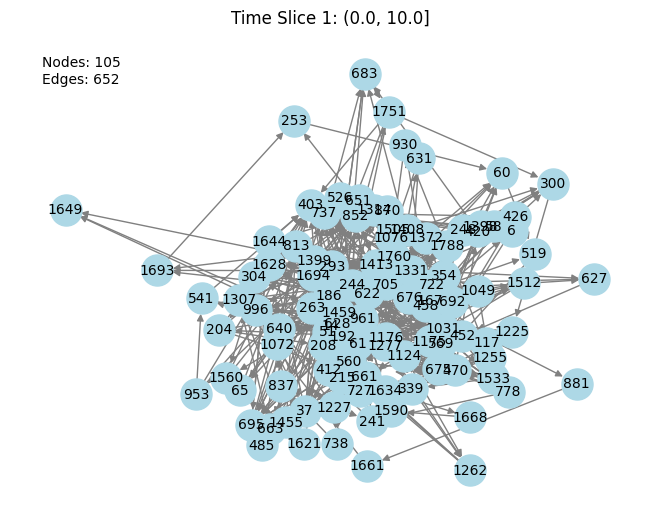

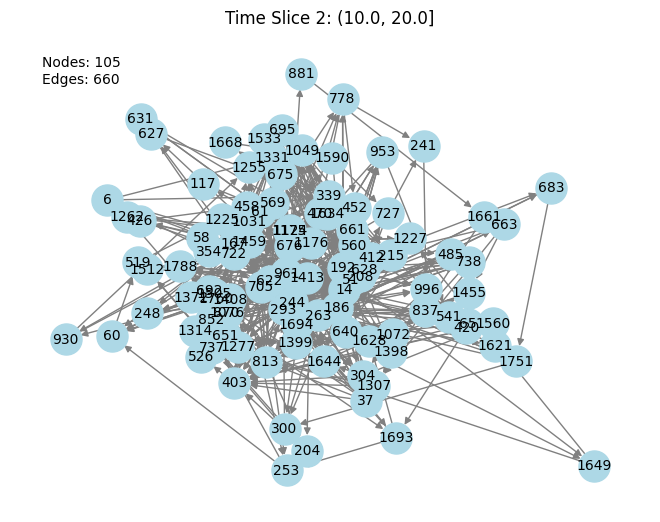

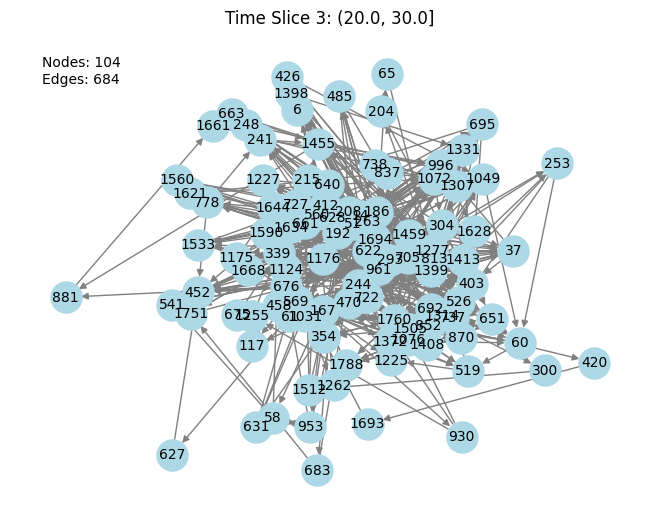

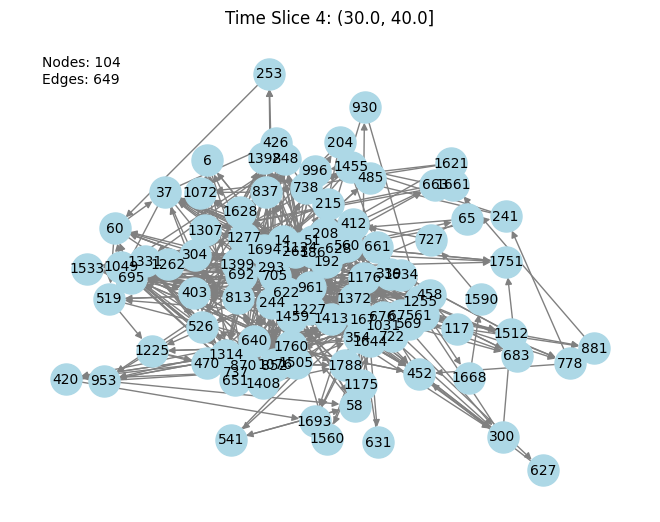

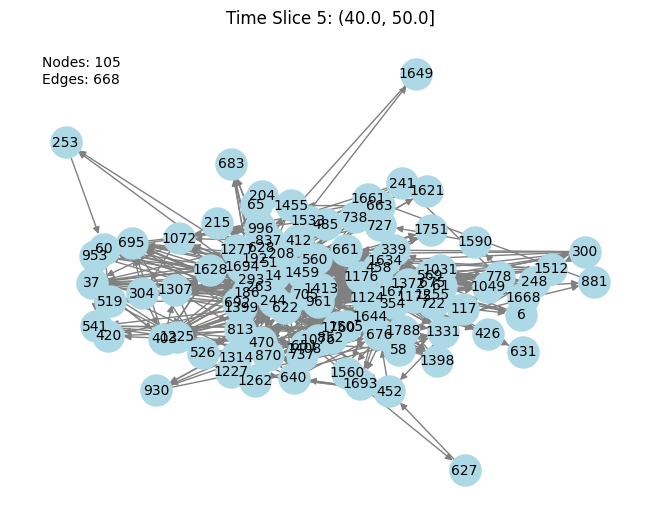

...

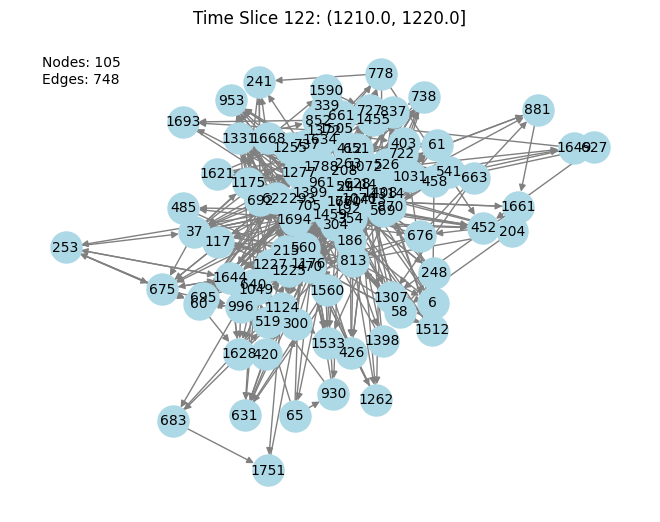

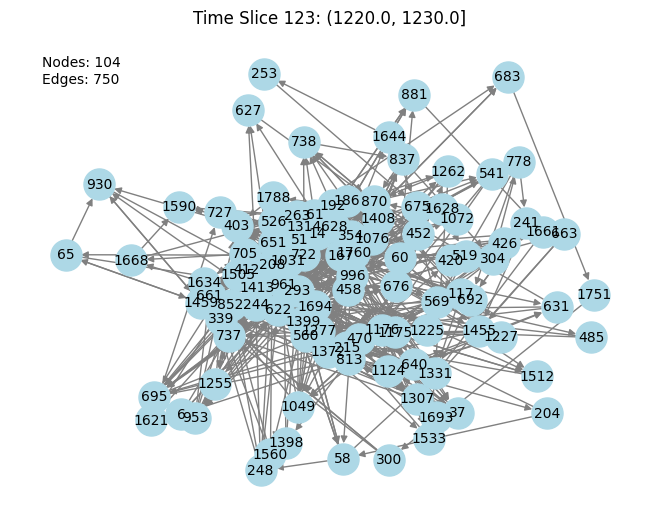

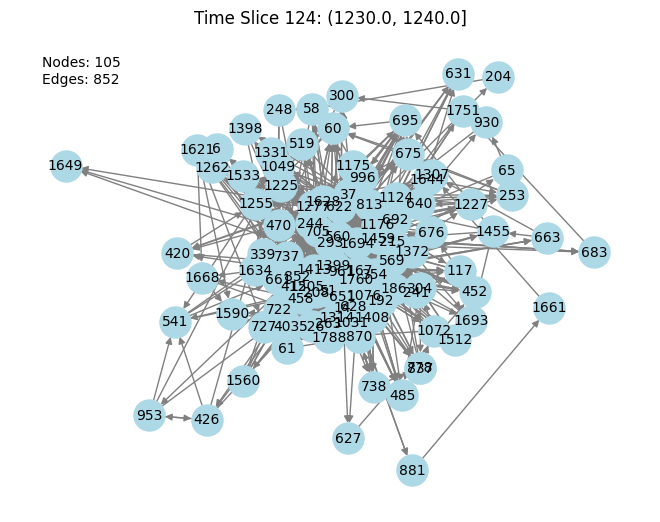

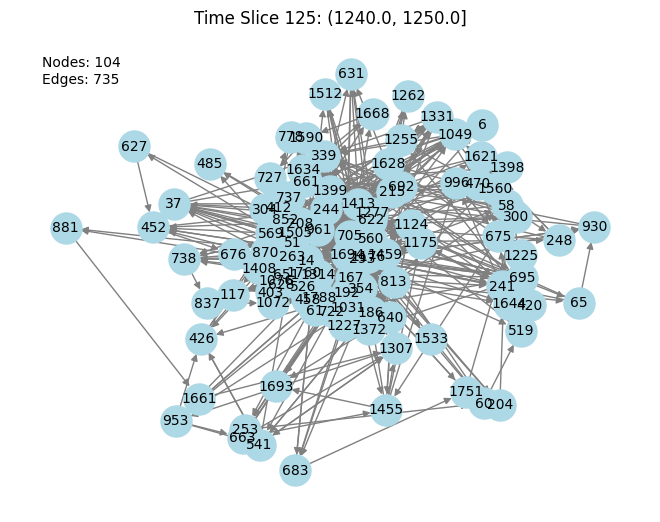

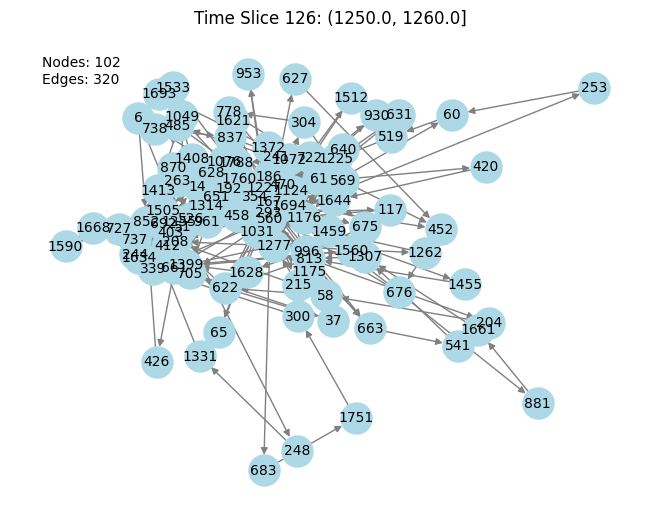

In [16]:
import networkx as nx
import matplotlib.pyplot as plt

# Define the time slice duration in seconds
time_slice_duration = 10.0

# Determine the number of time slices
num_slices = int(df['time'].max() / time_slice_duration) + 1

# Lists to store the number of nodes and edges for each time slice
nodes_count = []
edges_count = []

# Iterate over the time slices
for i in range(num_slices):
    start_time = i * time_slice_duration
    end_time = (i + 1) * time_slice_duration
    time_slice_label = f"Time Slice {i + 1}: ({start_time}, {end_time}]"
    time_slice_df = df[(df['time'] > start_time) & (df['time'] <= end_time)]

    # Build the graph for the current time slice
    G = nx.DiGraph()
    node_ids = time_slice_df['pid'].unique().tolist()
    G.add_nodes_from(node_ids)

    for j in range(len(time_slice_df) - 1):
        source = time_slice_df.iloc[j]['pid']
        target = time_slice_df.iloc[j+1]['pid']

        if G.has_edge(source, target):
            G[source][target]['weight'] += 1
        else:
            G.add_edge(source, target, weight=1)

    # Record the number of nodes and edges for this time slice
    nodes_count.append(len(G.nodes()))
    edges_count.append(len(G.edges()))

    # Plot the graph
    plt.figure(i)
    nx.draw(G, with_labels=True, node_color='lightblue', node_size=500, font_size=10, edge_color='gray')
    plt.title(time_slice_label)
    plt.text(0.05, 0.95, f'Nodes: {nodes_count[-1]}\nEdges: {edges_count[-1]}', transform=plt.gca().transAxes, verticalalignment='top')

plt.show()


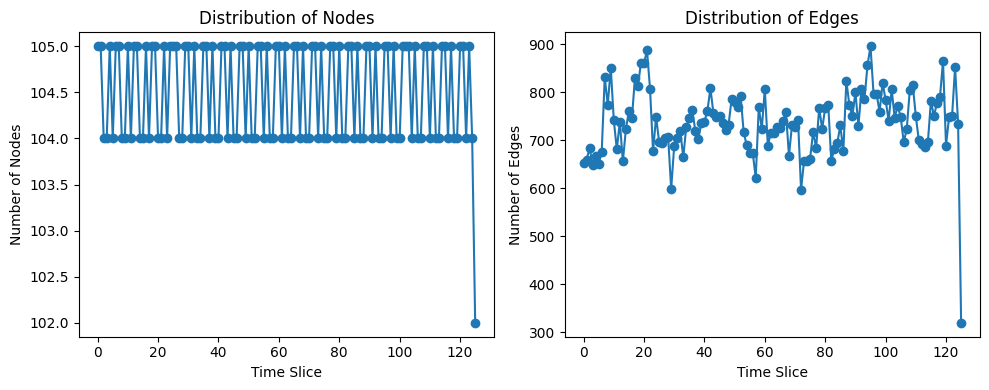

In [17]:
# Plot the distribution of nodes and edges across time slices
plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.plot(nodes_count, 'o-')
plt.title('Distribution of Nodes')
plt.xlabel('Time Slice')
plt.ylabel('Number of Nodes')

plt.subplot(1, 2, 2)
plt.plot(edges_count, 'o-')
plt.title('Distribution of Edges')
plt.xlabel('Time Slice')
plt.ylabel('Number of Edges')

plt.tight_layout()
plt.show()


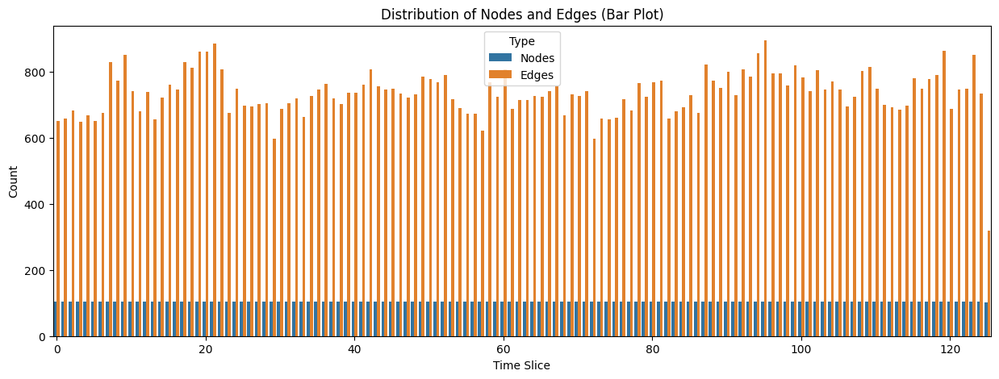

In [24]:
# Plot barplot
plt.figure(figsize=(15, 5))
sns.barplot(x='Time Slice', y='Count', hue='Type', data=distribution_df)
plt.title('Distribution of Nodes and Edges (Bar Plot)')
plt.xlabel('Time Slice')
plt.ylabel('Count')
plt.legend(title='Type')
plt.xticks(ticks=range(0, num_slices, 20), labels=range(0, num_slices, 20))  # Show only every 20th label
plt.show()


In [18]:
# Import necessary modules and classes for working with CAN (Controller Area Network) captures
import os
from CAN_objects.capture import MappedCapture, MatchedCapture

In [13]:
# Define the file path for the CAN capture and load the data from the pickle file
cancap_filepath = os.path.join("C:\\Users\\willi\\Dropbox\\data-cancaptures", "road_ambient_dyno_drive_basic_long_050305_002000", "capture.pkl")
cancap = unpickle(cancap_filepath)


In [14]:
# Define the file path for the ground truth DBC file and create a MappedCapture object from the CAN capture data and DBC file
ground_truth_dbc_fpath = os.path.join("C:\\Users\\willi\\Dropbox\\data-cancaptures\\DBC", "anonymized_020822_030640.dbc")
mapped_capture = MappedCapture.init_from_dbc(cancap, ground_truth_dbc_fpath)

### Function to extract the mean and standard deviation for a specific ID in a given time window.

In [15]:
def extract_mean_std_for_id(node_id, start_time, end_time, mapped_capture):
    # Extract the mapped payload for the given ID
    mp = mapped_capture.mapped_payload_dict[node_id]

    # Get the mask for the current time window
    mask = (mp.times >= start_time) & (mp.times < end_time)

    # Create a sub-DataFrame for the current time window
    sub_df = pd.DataFrame()

    for signal in mp.signal_list:
        signal_values = signal.values[mask]
        interpolated_values = pd.Series(signal_values).interpolate(method='linear', limit_area='inside').values
        sub_df[signal.name] = interpolated_values

    # Compute the mean and std for the sub-DataFrame
    mean_std_dict = {}
    for col, (mean, std) in zip(sub_df.columns, zip(sub_df.mean().values, sub_df.std().values)):
        mean_std_dict[f"{col}_mean"] = round(mean, 2)
        mean_std_dict[f"{col}_std"] = round(std, 2)

    return mean_std_dict


### Annotate the nodes with the mean and std attributes

In [ ]:
# Importing necessary libraries
import plotly.graph_objects as go
import networkx as nx
from IPython.display import clear_output
import pandas as pd
import math

# Function to create annotated edges with arrows
def create_annotated_edges(G, pos):
    edge_traces = []
    arrow_annotations = []
    for edge in G.edges():
        x0, y0 = pos[edge[0]]
        x1, y1 = pos[edge[1]]
        # Create line trace for edge
        edge_trace = go.Scatter(x=[x0, x1, None], y=[y0, y1, None],
                                line=dict(width=0.1, color='gray'),
                                mode='lines')
        edge_traces.append(edge_trace)

        # Create arrow annotation for the directed edge
        arrow_annotation = dict(
            ax=x0,
            ay=y0,
            axref='x',
            ayref='y',
            x=x1,
            y=y1,
            xref='x',
            yref='y',
            showarrow=True,
            arrowhead=4,
            arrowsize=1,
            arrowwidth=1,
            arrowcolor='gray'
        )
        arrow_annotations.append(arrow_annotation)

    return edge_traces, arrow_annotations

# Define time slice duration
time_slice_duration = 10.0
num_slices = int(df['time'].max() / time_slice_duration) + 1

# Loop through time slices and create directed graphs
for i in range(num_slices):
    start_time = i * time_slice_duration
    end_time = (i + 1) * time_slice_duration
    time_slice_label = f"Time Slice {i + 1}: ({start_time}, {end_time}]"
    time_slice_df = df[(df['time'] > start_time) & (df['time'] <= end_time)]

    # Create directed graph
    G = nx.DiGraph()
    node_ids = time_slice_df['pid'].unique().tolist()
    G.add_nodes_from(node_ids)

    # Add node attributes
    for node_id in node_ids:
        mean_std_dict = extract_mean_std_for_id(node_id, start_time, end_time, mapped_capture)
        nx.set_node_attributes(G, {node_id: mean_std_dict})

    # Add edges with weights
    for j in range(len(time_slice_df) - 1):
        source = time_slice_df.iloc[j]['pid']
        target = time_slice_df.iloc[j + 1]['pid']
        if G.has_edge(source, target):
            G[source][target]['weight'] += 1
        else:
            G.add_edge(source, target, weight=1)

    # Layout, annotations and visualizations
    pos = nx.spring_layout(G, k=0.15)
    edge_traces, arrow_annotations = create_annotated_edges(G, pos)

    # Create node positions and texts
    node_x = [pos[node][0] for node in G.nodes()]
    node_y = [pos[node][1] for node in G.nodes()]
    node_text = [f"Node ID: {node}<br>" + "<br>".join([f"{k}: {v}" for k, v in attrs.items()]) for node, attrs in G.nodes(data=True)]

    # Create node trace for visualization
    node_trace = go.Scatter(
        x=node_x, y=node_y,
        mode='markers+text',
        text=[str(node) for node in G.nodes()],
        textposition='middle center',
        textfont=dict(size=10, color='black'),
        hoverinfo='text',
        hovertext=node_text,
        marker=dict(
            showscale=True,
            colorscale='YlGnBu',
            size=30,
            colorbar=dict(
                thickness=15,
                title='Node Connections',
                xanchor='left',
                titleside='right'
            ),
            line_width=2
        )
    )

    # Build and display the figure
    fig = go.Figure(data=[*edge_traces, node_trace],
                    layout=go.Layout(
                        showlegend=False,
                        hovermode='closest',
                        margin=dict(b=0, l=0, r=0, t=40),
                        title=dict(
                            text=time_slice_label,
                            x=0.5,
                            xanchor='center',
                            font=dict(
                                size=14,
                                color='black'
                            )
                        ),
                        xaxis=dict(showgrid=False, zeroline=False),
                        yaxis=dict(showgrid=False, zeroline=False),
                        annotations=arrow_annotations
                    )
    )
    fig.show()

    # Prompt to continue to next plot
    input("Press Enter to continue...")
    clear_output(wait=True)
